### Libreta de  Análisis exploratorio de Datos. (EDA)

### Notebook for Exploratory Data Analysis. (EDA)


En esta libreta importaremos el archivo que contiene la unión de los dataframes previamente tratados para realizar un EDA.

In this notebook we will import the previous file of combined dataframes  to perform an EDA.

In [1]:
#import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import calplot

from sklearn import preprocessing

Las preguntas que   estamos tratando de contestar son:

+cuales son las variables meteorologicas que tienen mayor impacto en el gasto de energía?

+Como afectan los días de lluvia el uso de energía?


### Outline
#### Secciones 
> Generales

>Graficas de variables meteorológicas

> Heatmaps: Temperatura

>PCA



Conclusiones 
 


### Generales

In [2]:
#set working directory  
#os.chdir('./files')
print(os.getcwd())

/Users/yhmve/nrgy_feng/2023_wip


In [3]:
#exploring available files 01
df = pd.read_csv('./Meteomatics/df_all.csv' )


In [4]:
df_dt = df.copy(deep = True) #create copy df

In [5]:
df_dt.head(2) #Verify heads

,Date,Energy_demand,Date_time,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
0,2007-01-01,1297.0,2007-01-01 01:00:00,1,0,1,1,2007,Winter,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2007-01-01,1255.0,2007-01-01 02:00:00,2,0,1,1,2007,Winter,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


At this point we found  some nan values from 2007 to 2010, from differences on sources

In [6]:
#format date 
df_dt['Date_time'] = pd.to_datetime(df_dt['Date_time'],format='%Y/%m/%d') #Convert column to datetime)
#df_dt.info()

In [7]:
df_dt.set_index('Date_time', inplace = True) #set datetime column as index

In [8]:
df_dt.tail(2) #verify latest registers

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2022-10-31 22:00:00,2022-10-31,2877.56,22,0,44,10,2022,Autumn,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-10-31 23:00:00,2022-10-31,2843.08,23,0,44,10,2022,Autumn,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
df_dt.head(10)

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2007-01-01 01:00:00,2007-01-01,1297.0,1,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 02:00:00,2007-01-01,1255.0,2,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 03:00:00,2007-01-01,1222.0,3,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 04:00:00,2007-01-01,1168.0,4,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 05:00:00,2007-01-01,1128.0,5,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 06:00:00,2007-01-01,1100.0,6,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 07:00:00,2007-01-01,1083.0,7,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 08:00:00,2007-01-01,1076.0,8,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-01 09:00:00,2007-01-01,1022.0,9,0,1,1,2007,Winter,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
df_dt = df_dt['2010/01/01':'2022/10/30'] #drop incomplete rows, our DT will start on 2010

In [11]:
df_dt.head(30)

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,2010-01-01,1450.0,0,4,53,1,2010,Winter,16.9,17.1,...,2.3,0.0,0.0,14.7,13.7,0.0,58.9,2.9,0.0,0.0
2010-01-01 01:00:00,2010-01-01,1329.0,1,4,53,1,2010,Winter,16.5,17.0,...,2.3,0.0,0.0,14.3,13.6,0.0,61.5,2.6,0.0,0.0
2010-01-01 02:00:00,2010-01-01,1279.0,2,4,53,1,2010,Winter,13.3,13.7,...,2.2,0.0,0.0,12.5,12.1,0.0,64.8,2.5,0.0,0.0
2010-01-01 03:00:00,2010-01-01,1234.0,3,4,53,1,2010,Winter,13.0,13.4,...,2.3,0.0,0.0,12.1,11.8,0.0,68.8,2.3,0.0,0.0
2010-01-01 04:00:00,2010-01-01,1179.0,4,4,53,1,2010,Winter,11.9,12.1,...,2.3,0.0,0.0,10.4,10.4,0.0,73.0,2.1,0.0,0.0
2010-01-01 05:00:00,2010-01-01,1133.0,5,4,53,1,2010,Winter,11.9,12.0,...,2.4,0.0,0.0,9.7,8.9,0.0,71.9,2.0,0.0,0.0
2010-01-01 06:00:00,2010-01-01,1104.0,6,4,53,1,2010,Winter,11.4,11.5,...,2.4,0.0,0.0,9.1,8.2,0.0,77.8,2.0,0.0,0.0
2010-01-01 07:00:00,2010-01-01,1085.0,7,4,53,1,2010,Winter,11.2,11.3,...,2.4,0.0,0.0,8.9,7.9,0.0,79.3,2.0,0.0,0.0
2010-01-01 08:00:00,2010-01-01,1067.0,8,4,53,1,2010,Winter,11.4,11.5,...,2.3,0.0,0.0,8.7,7.6,0.0,79.0,2.0,0.0,0.0


In [12]:
#Checking for null values
[(df_dt.isnull().sum())] # check for null values, found 36 nulls 


[Date                    0
 Energy_demand           0
 Hour                    0
 Week_day                0
 Week                    0
                        ..
 Precipitation_Obr      36
 Humidity_Obr           36
 Wind_Velocity_Obr      36
 Solar_Radiation_Obr    36
 Cloudiness_Obr         36
 Length: 78, dtype: int64]

In [13]:
df_dt.isnull().sum().sum() # Complete df nulls


2681

In [14]:
df_dt = df_dt.dropna() # Delete NAs


In [15]:
#df_dt.tail(3)
df_dt.isnull().sum().sum() # Complete df nulls

0

In [16]:
#check for duplicated items
df_dt.duplicated().sum()

0

In [17]:
df_dt.head(2)

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,2010-01-01,1450.0,0,4,53,1,2010,Winter,16.9,17.1,...,2.3,0.0,0.0,14.7,13.7,0.0,58.9,2.9,0.0,0.0
2010-01-01 01:00:00,2010-01-01,1329.0,1,4,53,1,2010,Winter,16.5,17.0,...,2.3,0.0,0.0,14.3,13.6,0.0,61.5,2.6,0.0,0.0


In [18]:
from pandas_profiling import ProfileReport
#prof = ProfileReport(df)
#prof.to_file(output_file='profile_nrg01_2023.html')

In [19]:
df_dt.describe().transpose() #overview of our dataframe

,count,mean,std,min,25%,50%,75%,max
Energy_demand,112405.0,2643.481702,823.417750,1008.0,1986.0,2473.91,3238.0,5402.72
Hour,112405.0,11.501303,6.921972,0.0,6.0,12.00,18.0,23.00
Week_day,112405.0,3.000730,1.999715,0.0,1.0,3.00,5.0,6.00
Week,112405.0,26.302362,14.955694,1.0,13.0,26.00,39.0,53.00
Month,112405.0,6.456368,3.423046,1.0,3.0,6.00,9.0,12.00
...,...,...,...,...,...,...,...,...
Precipitation_Obr,112405.0,0.039120,0.316272,0.0,0.0,0.00,0.0,18.37
Humidity_Obr,112405.0,55.003629,22.628216,2.9,36.4,55.10,73.4,100.00
Wind_Velocity_Obr,112405.0,2.338353,1.286396,0.0,1.5,2.10,3.0,82.00
Solar_Radiation_Obr,112405.0,246.090380,322.711837,0.0,0.0,1.80,508.4,1098.80


In [20]:
df_dt.sample(5) #sample 5 rowa

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2015-11-22 16:00:00,2015-11-22,1975.04,16,6,47,11,2015,Autumn,33.3,34.8,...,1.6,393.9,0.0,30.3,31.4,0.0,24.0,1.6,400.9,0.0
2020-12-29 04:00:00,2020-12-29,1811.00,4,1,53,12,2020,Winter,12.4,13.2,...,2.1,0.0,99.6,12.7,13.3,0.0,98.2,1.7,0.0,22.4
2012-03-01 21:00:00,2012-03-01,1976.00,21,3,9,3,2012,Spring,19.9,19.3,...,2.4,0.0,0.0,20.0,17.5,0.0,46.2,3.2,0.0,0.0
2019-04-18 08:00:00,2019-04-18,2083.78,8,3,16,4,2019,Spring,15.7,16.4,...,0.0,2.1,0.0,13.5,14.9,0.0,69.4,0.4,2.4,0.0
2015-11-29 04:00:00,2015-11-29,1757.41,4,6,48,11,2015,Autumn,22.7,25.0,...,1.7,0.0,0.0,19.1,19.1,0.0,66.5,1.4,0.0,85.2


In [21]:
#correlation of columns
df_dt.corr()

,Energy_demand,Hour,Week_day,Week,Month,Year,Temperature_Cul,Perceived_Temperature_Cul,Precipitation_Cul,Humidity_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Energy_demand,1.000000,0.151925,-0.056220,0.270783,0.278709,0.432843,0.640366,0.583282,0.107793,0.028228,...,0.058958,0.147759,-0.134103,0.665285,0.639550,0.056298,0.011062,0.164531,0.131420,0.072398
Hour,0.151925,1.000000,0.000245,-0.000107,-0.000083,0.000044,0.414175,0.320092,0.015037,-0.462098,...,0.302795,0.275702,-0.013467,0.384867,0.325660,0.013492,-0.437742,0.343557,0.272733,0.011872
Week_day,-0.056220,0.000245,1.000000,0.001207,-0.000659,0.000274,0.003829,0.006362,-0.015685,-0.000498,...,0.003168,-0.001381,0.005218,0.008851,0.004036,-0.004510,-0.018221,0.007381,0.001803,-0.010251
Week,0.270783,-0.000107,0.001207,1.000000,0.967610,-0.029802,0.238400,0.216308,0.076774,0.171132,...,-0.101912,-0.055858,0.022345,0.222748,0.201202,0.052142,0.163234,-0.084460,-0.055420,0.101794
Month,0.278709,-0.000083,-0.000659,0.967610,1.000000,-0.032095,0.244967,0.222222,0.077828,0.170353,...,-0.098549,-0.053927,0.021235,0.229665,0.207453,0.051643,0.160258,-0.085101,-0.053735,0.100128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Precipitation_Obr,0.056298,0.013492,-0.004510,0.052142,0.051643,0.000150,0.048940,0.056536,0.111889,0.059219,...,-0.007478,0.008436,0.080453,0.034364,0.045686,1.000000,0.128615,0.050875,-0.019908,0.307517
Humidity_Obr,0.011062,-0.437742,-0.018221,0.163234,0.160258,-0.019961,-0.411444,-0.386176,0.095243,0.784367,...,-0.356376,-0.573516,0.180020,-0.409891,-0.350551,0.128615,1.000000,-0.402272,-0.590696,0.231334
Wind_Velocity_Obr,0.164531,0.343557,0.007381,-0.084460,-0.085101,0.152412,0.309365,0.273728,0.022548,-0.389435,...,0.396103,0.307355,0.026009,0.299882,0.277177,0.050875,-0.402272,1.000000,0.302514,0.062876
Solar_Radiation_Obr,0.131420,0.272733,0.001803,-0.055420,-0.053735,-0.003924,0.615083,0.754972,0.001272,-0.650185,...,0.341232,0.974449,-0.031728,0.557355,0.717270,-0.019908,-0.590696,0.302514,1.000000,0.031360


### Boxplots

In [22]:
# Reviewing Hourly data
fig = go.Figure()

x = df_dt['Hour']
y = df_dt['Energy_demand']
fig = px.box (df_dt, x , y, color = x)
#fig.update_traces(quartilemethod= "exclusive")  
fig.show(renderer='notebook')

In [23]:
# Reviewing  Season Data
fig = go.Figure()

x = df_dt['Season']
y = df_dt['Energy_demand']
fig = px.violin(df, x , y, color = x,
                box=True, points = 'outliers')
                
fig.update_xaxes(type='-') 

fig.update_traces(quartilemethod= "exclusive", 
                scalemode = 'width')  
fig.show(renderer='notebook')

### Plot the time series

In [24]:
fig = go.Figure([go.Scatter(x=df_dt['Date'], y=df_dt['Energy_demand'])])
fig.update_layout(title='Requerimiento de Energía')
fig.show()


Scatterplots.

Investigating relationships between two variables. Scatterplots. Correlation. Scatterplot matrices.

In [25]:
df_sample = df_dt.sample(n=2000)

#for feature in features:
fig_feature = px.scatter(df_sample, x='Month', y='Energy_demand', #y=feature,
                    size = 'Energy_demand',
                    color = 'Year',
                    #color_discrete_sequence=px.colors.qualitative.Dark2,
                    #hover_name = Week_day,
                    #marginal_y='box',
                    category_orders={'Season': 'Season',
                                     'Energía': 'Energy_demand'},
                  )
fig_feature.update_layout(
    title="Gasto de energia a traves del tiempo por Mes",
    xaxis_title="Mes",
    yaxis_title="Demanda de energía",
    legend_title="Demanda de Energía por mes",
    font=dict(
        family="Helvetica",
        size=12,
        color="Gray"
    )
)
fig_feature.show( renderer = 'notebook')

In [26]:
col_list_ca = [col for col in df_dt.columns if col.endswith('_Ca')] #define list for columns caborca


In [27]:
#df_dt.drop(columns=['Date_time'], inplace=True) drop dup column
df_dt.head(2)

,Date,Energy_demand,Hour,Week_day,Week,Month,Year,Season,Temperature_Cul,Perceived_Temperature_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
Date_time,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,2010-01-01,1450.0,0,4,53,1,2010,Winter,16.9,17.1,...,2.3,0.0,0.0,14.7,13.7,0.0,58.9,2.9,0.0,0.0
2010-01-01 01:00:00,2010-01-01,1329.0,1,4,53,1,2010,Winter,16.5,17.0,...,2.3,0.0,0.0,14.3,13.6,0.0,61.5,2.6,0.0,0.0


In [28]:
df_dt.shape

(112405, 78)

###  charts by weather variables and cities

In [29]:
#Create dataframe for Culiacan
cul = pd.concat([df_dt.iloc[:,0:5],df_dt.iloc[:,6:13]], axis = 1)

#### Lluvia
Precipitation

In [30]:
#Precipitation chart
Prec= [col for col in df_dt.columns if col.startswith('Prec')] #list
Prec_df = df_dt[[c for c in df_dt.columns if c in Prec]] #Dataframe

In [31]:
Prec_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Precipitation_Cul,112405.0,0.069079,0.427254,0.0,0.0,0.0,0.0,16.65
Precipitation_Ca,112405.0,0.016639,0.226222,0.0,0.0,0.0,0.0,23.39
Precipitation_Herm,112405.0,0.030155,0.287973,0.0,0.0,0.0,0.0,28.34
Precipitation_Guas,112405.0,0.055892,0.390832,0.0,0.0,0.0,0.0,16.60
Precipitation_Guay,112405.0,0.025834,0.285769,0.0,0.0,0.0,0.0,19.32
Precipitation_Maz,112405.0,0.098217,0.607908,0.0,0.0,0.0,0.0,27.97
Precipitation_Moch,112405.0,0.040030,0.305498,0.0,0.0,0.0,0.0,20.82
Precipitation_Nav,112405.0,0.041807,0.304972,0.0,0.0,0.0,0.0,11.96
Precipitation_Nog,112405.0,0.030785,0.450565,0.0,0.0,0.0,0.0,82.00
Precipitation_Obr,112405.0,0.039120,0.316272,0.0,0.0,0.0,0.0,18.37


In [32]:
# Identify outlier in Precipitation Nogales
Prec_df.loc[Prec_df['Precipitation_Nog'] > 68]

,Precipitation_Cul,Precipitation_Ca,Precipitation_Herm,Precipitation_Guas,Precipitation_Guay,Precipitation_Maz,Precipitation_Moch,Precipitation_Nav,Precipitation_Nog,Precipitation_Obr
Date_time,,,,,,,,,,
2020-06-01 17:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,82.0,0.0
2020-06-01 18:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,82.0,0.0


In [33]:
#create boxplot for Precipitation
fig = go.Figure()
for col in Prec_df:
    fig.add_trace(go.Box(y=Prec_df[col].values, name=Prec_df[col].name))
  
#fig.update_layout(yaxis_range=[-10,130])

fig.show(renderer='notebook')

#### Nubosidad
Cloudiness

In [34]:
#Cloudliness chart
Cloud= [col for col in df_dt.columns if col.startswith('Cloud')] #list
Cloud_df = df_dt[[c for c in df_dt.columns if c in Cloud]] #Dataframe

In [35]:
Cloud_df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Cloudiness_Cul,112405.0,9.207017,19.162283,0.0,0.0,0.0,8.2,100.0
Cloudiness_Ca,112405.0,2.269581,10.165317,0.0,0.0,0.0,0.0,100.0
Cloudiness_Herm,112405.0,2.498416,10.142171,0.0,0.0,0.0,0.0,100.0
Cloudiness_Guas,112405.0,7.043685,16.878585,0.0,0.0,0.0,3.6,100.0
Cloudiness_Guay,112405.0,2.701943,9.931778,0.0,0.0,0.0,0.0,100.0
Cloudiness_Maz,112405.0,11.539559,20.437487,0.0,0.0,0.4,14.2,100.0
Cloudiness_Moch,112405.0,6.026870,15.428792,0.0,0.0,0.0,2.3,100.0
Cloudiness_Nav,112405.0,3.958089,12.368498,0.0,0.0,0.0,0.3,100.0
Cloudiness_Nog,112405.0,4.298578,15.295748,0.0,0.0,0.0,0.0,100.0
Cloudiness_Obr,112405.0,3.702264,12.004732,0.0,0.0,0.0,0.2,100.0


In [36]:
Cloud_df.isnull().sum()

Cloudiness_Cul     0
Cloudiness_Ca      0
Cloudiness_Herm    0
Cloudiness_Guas    0
Cloudiness_Guay    0
Cloudiness_Maz     0
Cloudiness_Moch    0
Cloudiness_Nav     0
Cloudiness_Nog     0
Cloudiness_Obr     0
dtype: int64

In [37]:
#create boxplot for Cloudliness
fig = go.Figure()
for col in Cloud_df:
    fig.add_trace(go.Box(y=Cloud_df[col].values, name=Cloud_df[col].name))
  
fig.show(renderer='notebook')

In [38]:
#storecolumn names of original df
list_columns = Cloud_df.columns.tolist()
print(list_columns)

['Cloudiness_Cul', 'Cloudiness_Ca', 'Cloudiness_Herm', 'Cloudiness_Guas', 'Cloudiness_Guay', 'Cloudiness_Maz', 'Cloudiness_Moch', 'Cloudiness_Nav', 'Cloudiness_Nog', 'Cloudiness_Obr']


In [39]:
#Temperature chart
Temp= [col for col in df_dt.columns if col.startswith('Temp')] #list
Temp_df = df[[c for c in df_dt.columns if c in Temp]] #Dataframe

In [40]:
#create boxplot for Temperature
fig = go.Figure()

for col in Temp_df:
    fig.add_trace(go.Box(y=Temp_df[col].values, name=Temp_df[col].name))
  
#fig.update_layout(yaxis_range=[0,60])
fig.show(renderer='notebook')

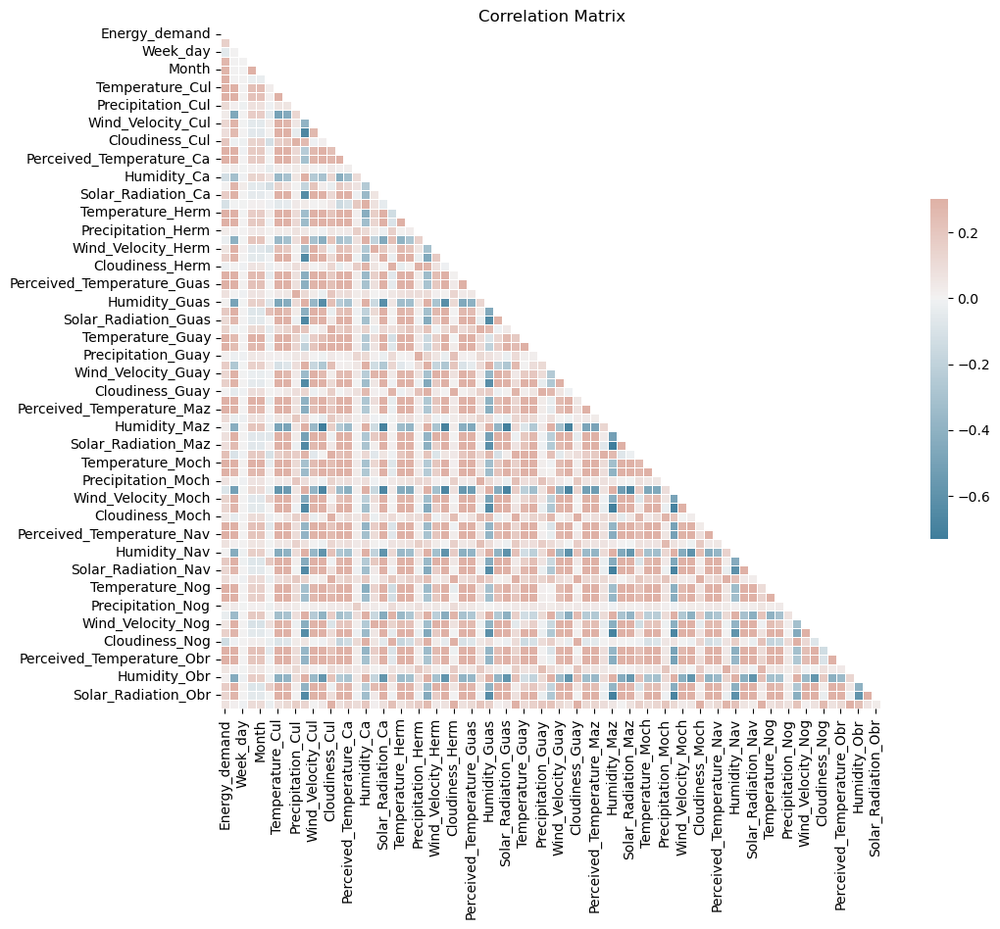

In [41]:
#correlation matrix
corrmat = df_dt.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corrmat, dtype=bool))

# color map
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Correlation Matrix ')

hm = sns.heatmap(corrmat, 
                 cbar=True, 
                 annot=False,
                 vmax = .3, 
                 #square=True, 
                 center  = 0,
                 linewidths=.5,
                 cbar_kws={"shrink": .5},
                 fmt='.2f', 
                 annot_kws={'size': 15},  
                 mask = mask,
                 cmap = cmap
                 )
plt.show();

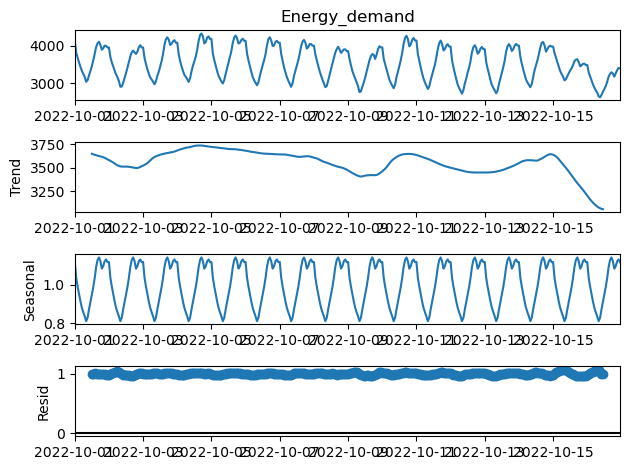

In [42]:
from statsmodels.tsa.seasonal import seasonal_decompose
final = seasonal_decompose(df_dt['Energy_demand']['2022-10-01':'2022-10-16'],model='multiplicative')
final.plot();

Heatmaps


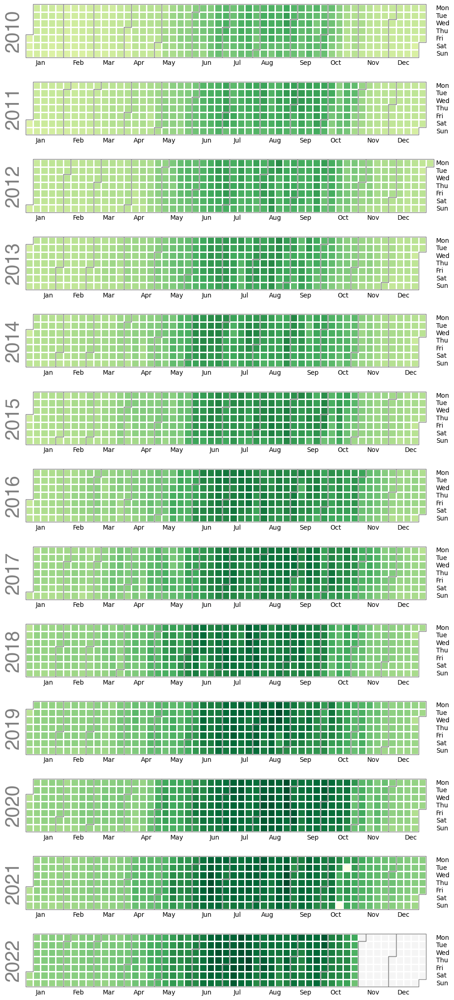

In [43]:
#Calplot  Energy Demand
calplot.calplot(df_dt['Energy_demand'], cmap='YlGn',colorbar=False);

    PCA
    Usando Sci- Kit learn

In [44]:
from sklearn.preprocessing import StandardScaler

In [62]:
#creating copy for pca
df_pc = df_dt.copy()
df_pc.drop(columns = ["Season","Date"], inplace= True) # drop string column

In [63]:
scaler = StandardScaler()
#scale_cols =  pd.concat([df_dt.iloc[:,1:6],df_dt.iloc[:,8:78]], axis = 1) #by excluding season
scaled_X = scaler.fit_transform((pd.concat([df_pc])))

In [64]:
scaled_X

array([[-1.44943075, -1.66157196,  0.49970864, ...,  0.43660679,
        -0.76257344, -0.30840177],
       [-1.5963799 , -1.51710381,  0.49970864, ...,  0.20339607,
        -0.76257344, -0.30840177],
       [-1.65710269, -1.37263567,  0.49970864, ...,  0.12565916,
        -0.76257344, -0.30840177],
       ...,
       [ 0.16171487,  1.37225909,  1.49985553, ..., -0.10755156,
        -0.76257344, -0.30840177],
       [ 0.20188906,  1.51672723,  1.49985553, ..., -0.18528846,
        -0.76257344, -0.30840177],
       [ 0.15756143,  1.66119538,  1.49985553, ..., -0.34076228,
        -0.76257344, -0.30840177]])

In [48]:
from sklearn.decomposition import PCA

In [66]:
pca = PCA(n_components=2)

In [67]:
principal_components = pca.fit_transform(scaled_X)

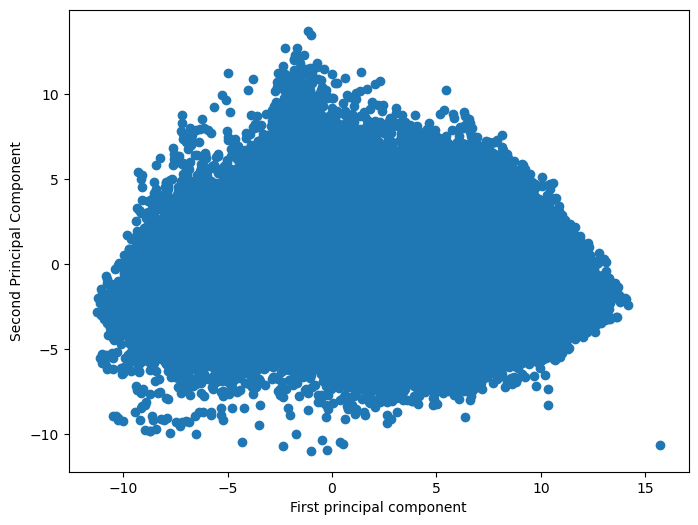

In [68]:
plt.figure(figsize=(8,6))
plt.scatter(principal_components[:,0],principal_components[:,1])
plt.xlabel('First principal component')
plt.ylabel('Second Principal Component');

In [69]:
pca.n_components

2

In [70]:
pca.components_

array([[ 0.09580512,  0.08390921,  0.00052777,  0.01848446,  0.01947821,
         0.00189821,  0.17310948,  0.17864266,  0.01086278, -0.11843085,
         0.07376953,  0.15226847,  0.02774774,  0.14885114,  0.16809267,
         0.00157818, -0.0877239 ,  0.02980261,  0.16212739, -0.01544159,
         0.16149733,  0.17259112,  0.00124756, -0.09672621,  0.05666308,
         0.16089729, -0.00298457,  0.17132244,  0.17860069,  0.00684039,
        -0.11799662,  0.07434115,  0.15565702,  0.02019009,  0.13166791,
         0.16093216, -0.00156675, -0.04391664,  0.07252023,  0.16116794,
        -0.00231166,  0.16441155,  0.17342352,  0.00499818, -0.12281784,
         0.09524832,  0.1500295 ,  0.02195245,  0.16273051,  0.17357626,
         0.00503286, -0.13596034,  0.08410108,  0.15795796,  0.00471002,
         0.16920762,  0.17807868,  0.00505199, -0.11590738,  0.08892074,
         0.15783522,  0.01449981,  0.15959666,  0.16953256,  0.00716224,
        -0.08915825,  0.07139162,  0.15982938, -0.0

each row represents a principal component

In [72]:
df_comp = pd.DataFrame(pca.components_,index=['PC1','PC2'],columns=df_pc.columns)

In [73]:
df_comp

,Energy_demand,Hour,Week_day,Week,Month,Year,Temperature_Cul,Perceived_Temperature_Cul,Precipitation_Cul,Humidity_Cul,...,Wind_Velocity_Nog,Solar_Radiation_Nog,Cloudiness_Nog,Temperature_Obr,Perceived_Temperature_Obr,Precipitation_Obr,Humidity_Obr,Wind_Velocity_Obr,Solar_Radiation_Obr,Cloudiness_Obr
PC1,0.095805,0.083909,0.000528,0.018484,0.019478,0.001898,0.173109,0.178643,0.010863,-0.118431,...,0.071392,0.159829,-0.022376,0.168935,0.177859,0.005942,-0.112308,0.078624,0.158763,0.012106
PC2,0.176549,-0.064100,-0.003874,0.147763,0.149296,-0.012957,0.075018,0.073083,0.081609,0.202028,...,-0.094786,-0.081247,0.031257,0.102388,0.098145,0.069320,0.210005,-0.081052,-0.089348,0.123482


In [74]:
pca.transform(scaled_X)


array([[-5.439635  , -3.06133552],
       [-5.78434109, -2.94069021],
       [-6.6197794 , -3.10129778],
       ...,
       [-3.07618056, -0.82467964],
       [-3.63401441, -0.56030981],
       [-3.87954801, -0.50628686]])

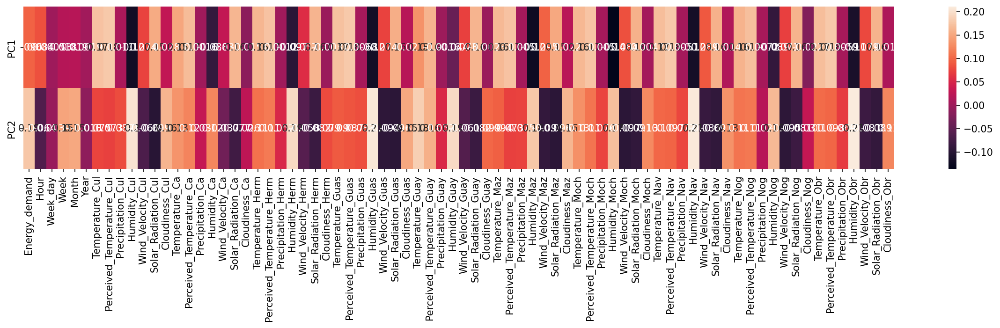

In [76]:
plt.figure(figsize=(20,3),dpi=150)
sns.heatmap(df_comp,annot=True);


In [77]:
pca.explained_variance_ratio_

array([0.36652517, 0.12437272])

In [78]:
np.sum(pca.explained_variance_ratio_)


0.4908978877223784